<a href="https://colab.research.google.com/github/mmaithani/data-science/blob/main/DeOldify_ImageColorize.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



---


# Correct Runtime Settings

In the "Runtime" menu for the notebook window, select "Change runtime type." Ensure that the following are selected:
* Runtime Type = Python 3
* Hardware Accelerator = GPU 


# Git clone and install DeOldify

## i have forked the official repo: [https://github.com/jantic/DeOldify](https://github.com/jantic/DeOldify) and added some test images for ease

In [5]:
!git clone https://github.com/mmaithani/DeOldify.git DeOldify 

Cloning into 'DeOldify'...
remote: Enumerating objects: 14, done.
remote: Counting objects: 100% (14/14), done.
remote: Compressing objects: 100% (14/14), done.
remote: Total 2201 (delta 3), reused 0 (delta 0), pack-reused 2187
Receiving objects: 100% (2201/2201), 72.44 MiB | 8.51 MiB/s, done.
Resolving deltas: 100% (999/999), done.


In [6]:
cd DeOldify

/content/DeOldify


# Setup

In [7]:
#NOTE:  This must be the first call in order to work properly!
from deoldify import device
from deoldify.device_id import DeviceId
#choices:  CPU, GPU0...GPU7
device.set(device=DeviceId.GPU0)

import torch

if not torch.cuda.is_available():
    print('GPU not available.')

In [8]:
!pip install -r colab_requirements.txt

     |████████████████████████████████| 215kB 4.1MB/s 
     |████████████████████████████████| 133kB 31.6MB/s 
     |████████████████████████████████| 1.9MB 44.9MB/s 
     |████████████████████████████████| 8.3MB 34.7MB/s 
     |████████████████████████████████| 81kB 9.4MB/s 
     |████████████████████████████████| 430kB 34.0MB/s 
     |████████████████████████████████| 51kB 7.0MB/s 
     |████████████████████████████████| 194kB 43.3MB/s 
     |████████████████████████████████| 61kB 7.7MB/s 
     |████████████████████████████████| 112kB 41.9MB/s 
     |████████████████████████████████| 71kB 3.9MB/s 
     |████████████████████████████████| 102kB 10.9MB/s 
  Created wheel for ffmpeg: filename=ffmpeg-1.4-cp36-none-any.whl size=6083 sha256=1a63ed720e3ce7bac2e75c0e472bd49c3d228226cc87dfa44e7bbd8cb082215d
  Stored in directory: /root/.cache/pip/wheels/b6/68/c3/a05a35f647ba871e5572b9bbfc0b95fd1c6637a2219f959e7a
  Created wheel for typing: filename=typing-3.7.4.3-cp36-none-any.whl size=26310 s

In [9]:
import fastai
from deoldify.visualize import *
import warnings
warnings.filterwarnings("ignore", category=UserWarning, message=".*?Your .*? set is empty.*?")

In [10]:
!mkdir 'models'
!wget https://data.deepai.org/deoldify/ColorizeArtistic_gen.pth -O ./models/ColorizeArtistic_gen.pth

--2021-01-08 09:00:17--  https://data.deepai.org/deoldify/ColorizeArtistic_gen.pth
Resolving data.deepai.org (data.deepai.org)... 138.201.36.183
Connecting to data.deepai.org (data.deepai.org)|138.201.36.183|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 255144681 (243M) [application/octet-stream]
Saving to: ‘./models/ColorizeArtistic_gen.pth’

./models/ColorizeAr 100%[===================>] 243.32M  11.4MB/s    in 23s     

2021-01-08 09:00:41 (10.4 MB/s) - ‘./models/ColorizeArtistic_gen.pth’ saved [255144681/255144681]



In [11]:
!wget https://media.githubusercontent.com/media/jantic/DeOldify/master/resource_images/watermark.png -O ./resource_images/watermark.png

--2021-01-08 09:00:41--  https://media.githubusercontent.com/media/jantic/DeOldify/master/resource_images/watermark.png
Resolving media.githubusercontent.com (media.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to media.githubusercontent.com (media.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 9210 (9.0K) [image/png]
Saving to: ‘./resource_images/watermark.png’

./resource_images/w 100%[===================>]   8.99K  --.-KB/s    in 0s      

2021-01-08 09:00:42 (42.5 MB/s) - ‘./resource_images/watermark.png’ saved [9210/9210]



In [12]:
colorizer = get_image_colorizer(artistic=True)

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth


# Let's Colorize!!

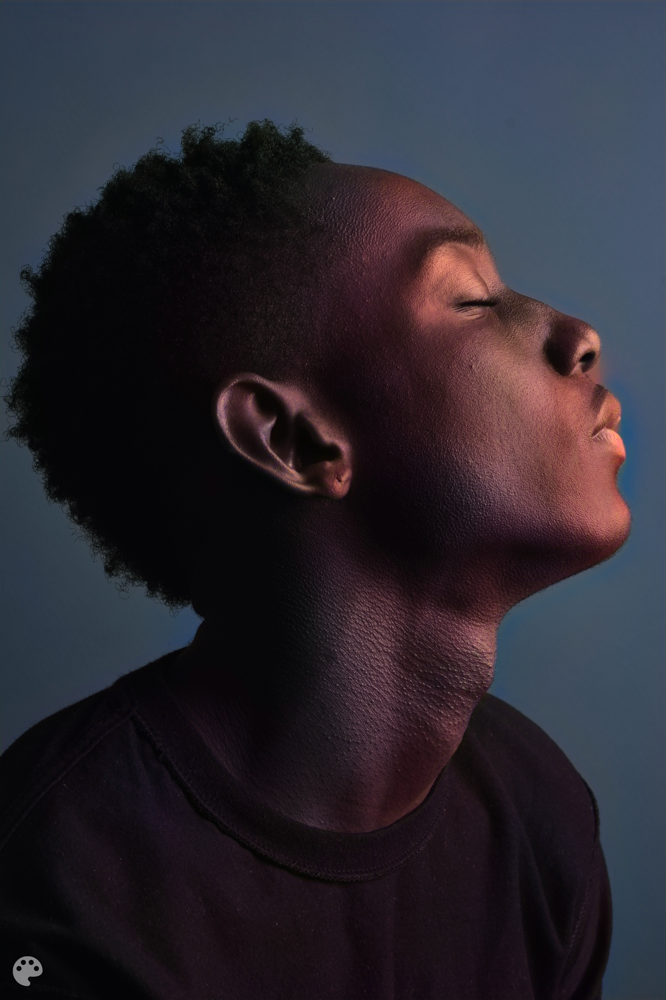

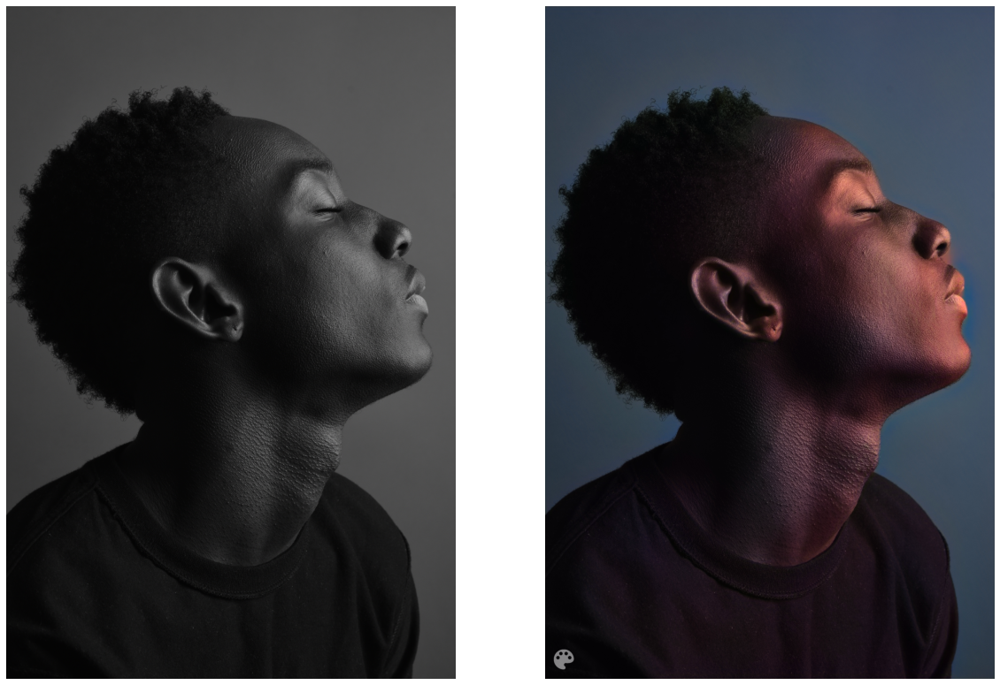

In [13]:
source_url = 'https://images.pexels.com/photos/3031397/pexels-photo-3031397.jpeg' #@param {type:"string"}
render_factor = 35  #@param {type: "slider", min: 7, max: 40}
watermarked = True #@param {type:"boolean"}

if source_url is not None and source_url !='':
    image_path = colorizer.plot_transformed_image_from_url(url=source_url, render_factor=render_factor, compare=True, watermarked=watermarked)
    show_image_in_notebook(image_path)
else:
    print('Provide an image url :) ')

## See how well render_factor values perform on the image here

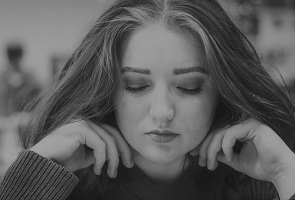

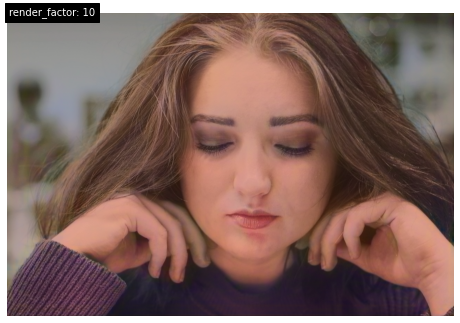

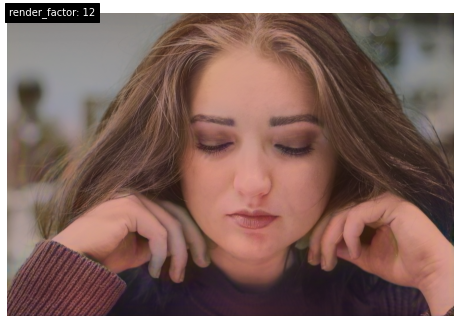

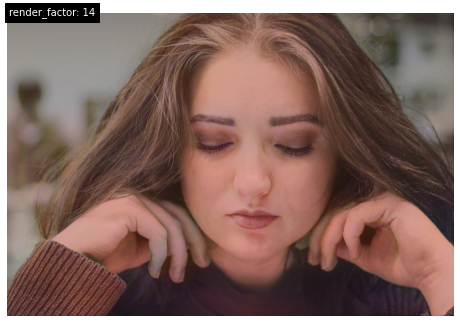

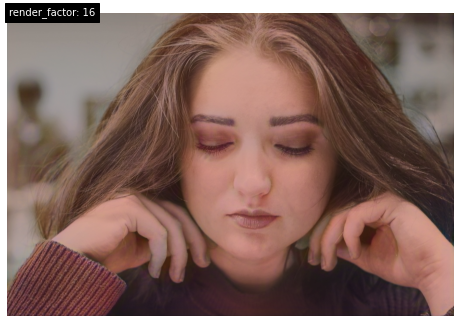

...

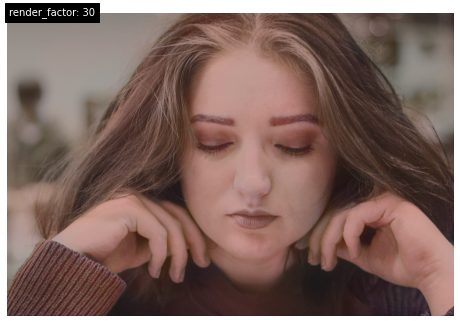

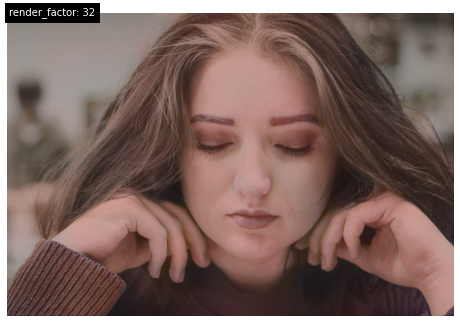

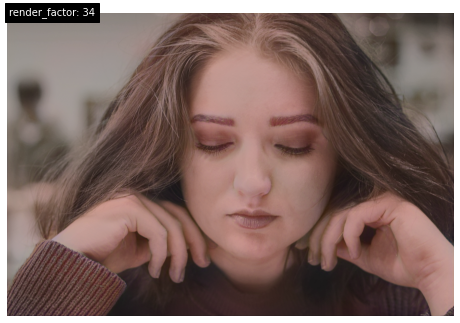

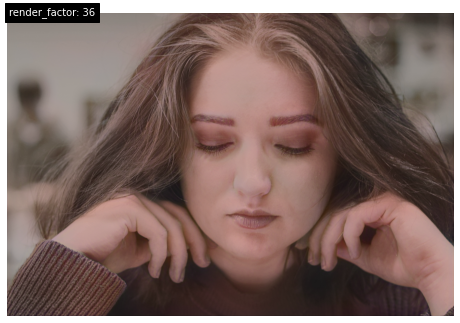

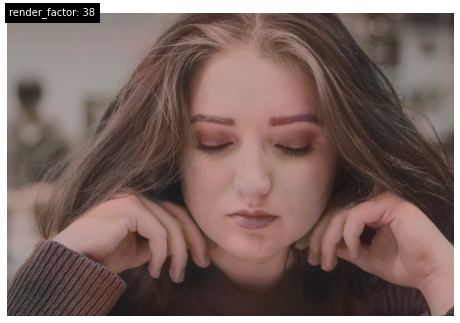

In [10]:
for i in range(10,40,2):
    colorizer.plot_transformed_image('/content/DeOldify/test_images/vic-P8Fxe0J8Flo-unsplash.jpg', render_factor=i, display_render_factor=True, figsize=(8,8))

## result(colored) image is stored in /DeOldify/test_images/
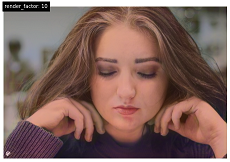

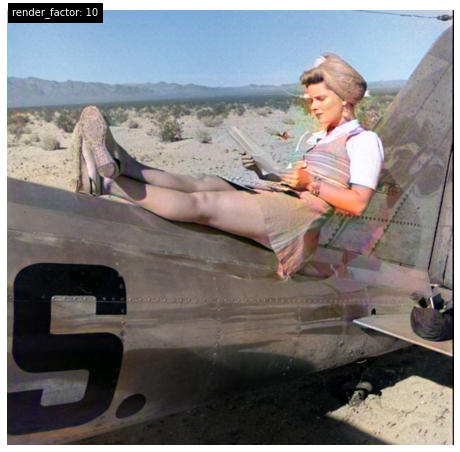

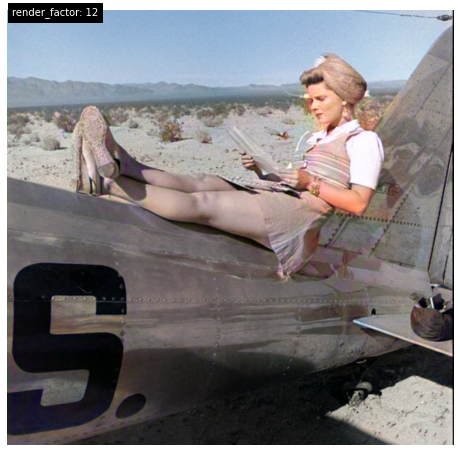

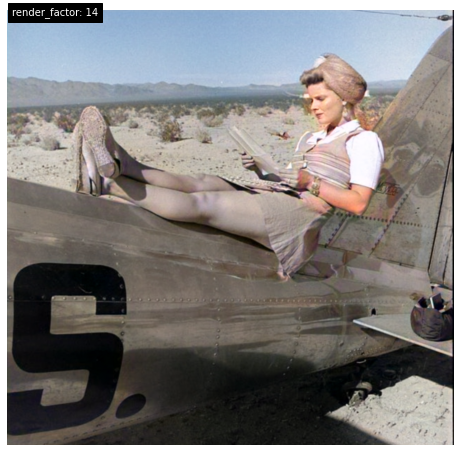

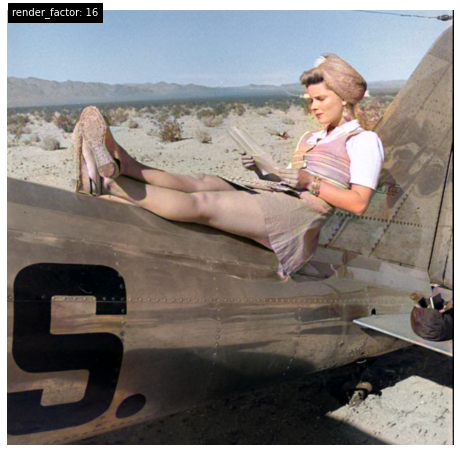

...

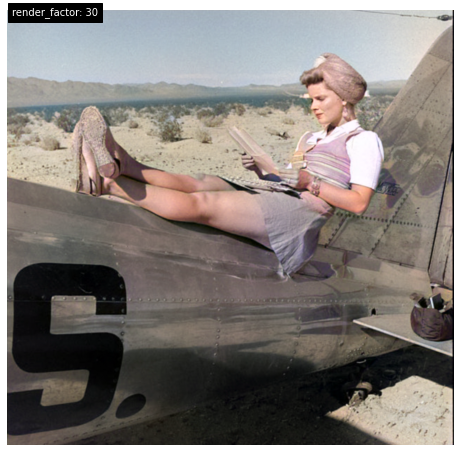

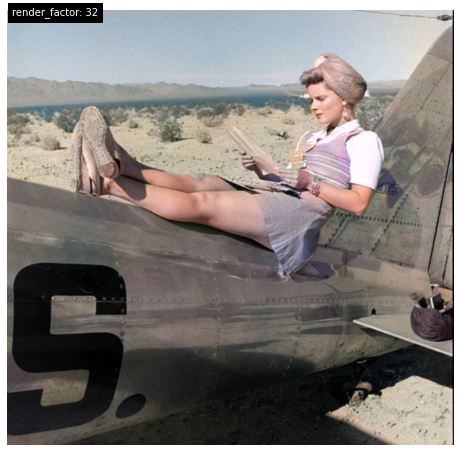

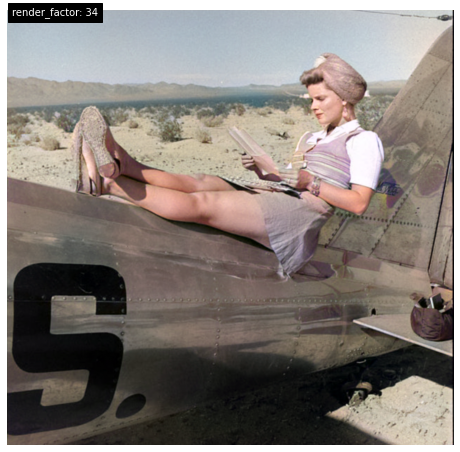

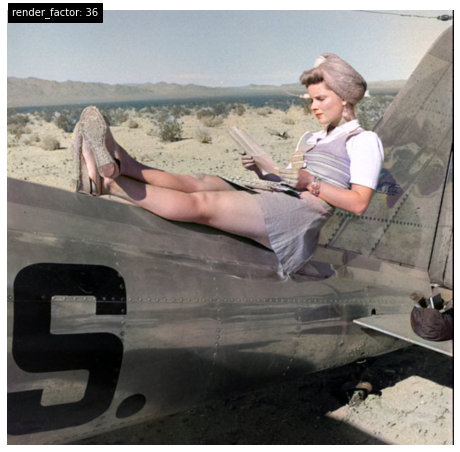

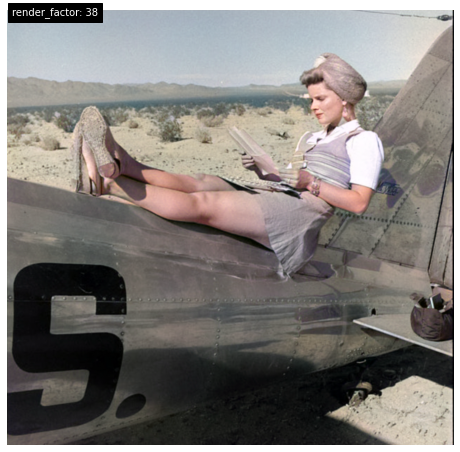

In [11]:
for i in range(10,40,2):
    colorizer.plot_transformed_image('/content/DeOldify/test_images/mvf78f3j7z961.png', render_factor=i, display_render_factor=True, figsize=(8,8))

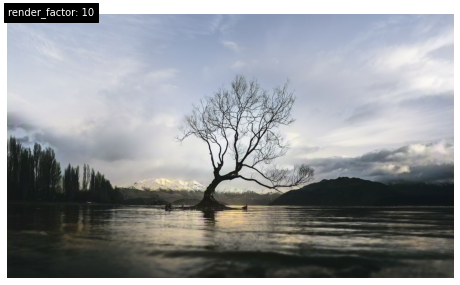

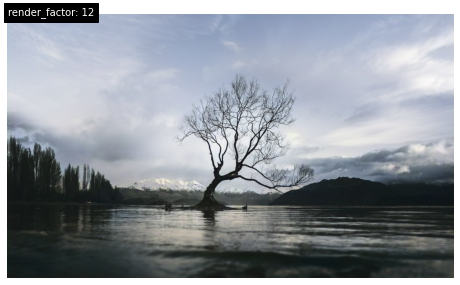

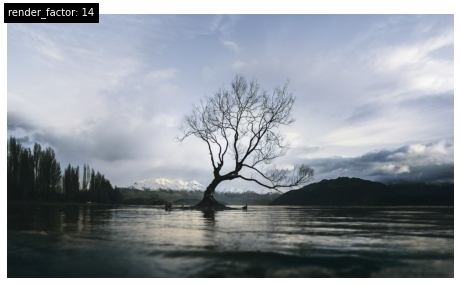

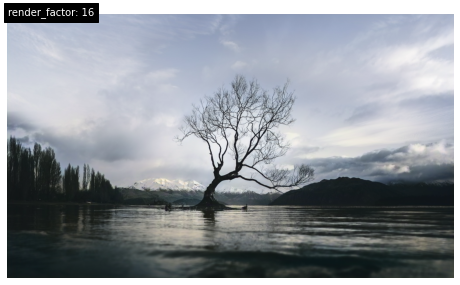

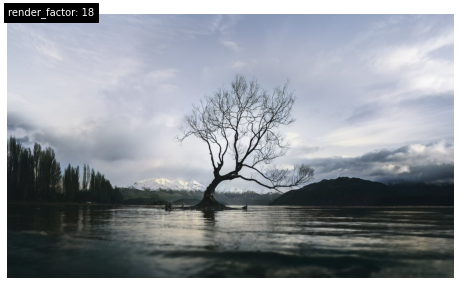

...

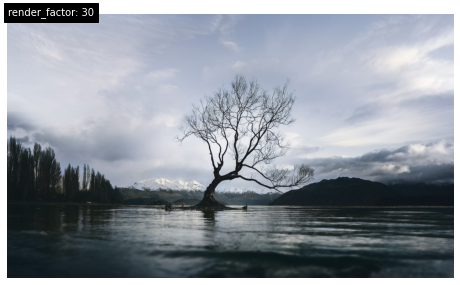

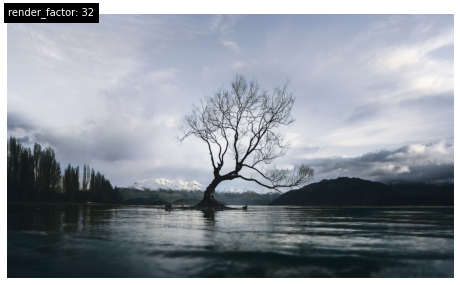

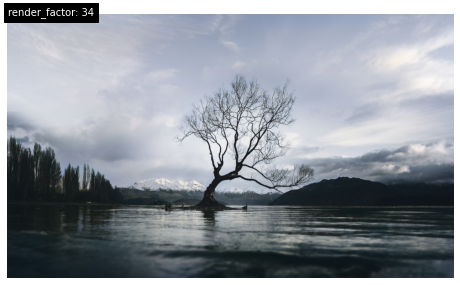

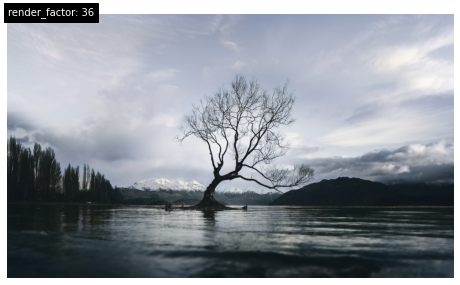

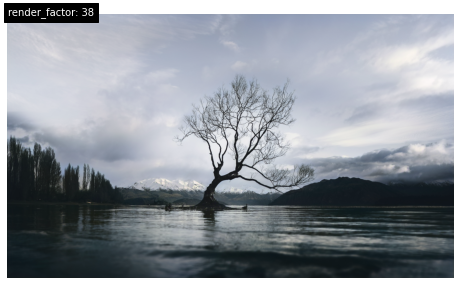

In [13]:
for i in range(10,40,2):
    colorizer.plot_transformed_image('/content/DeOldify/test_images/black-and-white-landscapes.jpg', render_factor=i, display_render_factor=True, figsize=(8,8))

In [ ]:
url="image url" #@param {type:"string"}
for i in range(10,40,2):
    colorizer.plot_transformed_image('/content/DeOldify/test_images/68747470733a2f2f692e696d6775722e636f6d2f427430766e6b652e6a7067 (2).jpg', render_factor=i, display_render_factor=True, figsize=(8,8))

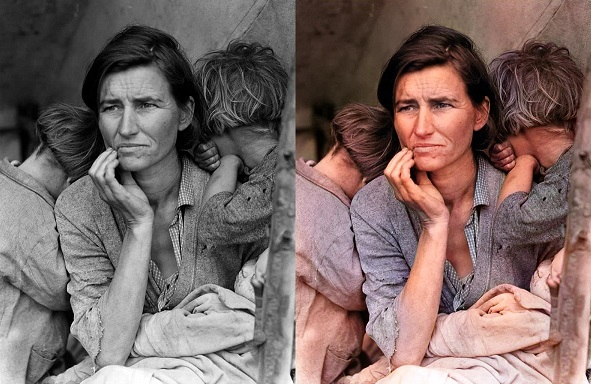